In [7]:
import pandas as pd 
import matplotlib.pyplot as plt


In [23]:
df = pd.read_csv('ChargePoint Data CY20Q4.csv', dtype={'Station Name': str}, parse_dates=['End Date', 'Start Date'], low_memory=False)
df = df.drop(["Org Name", "Country", "Start Time Zone", "End Time Zone"], axis=1)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 259415 entries, 0 to 259414
Data columns (total 29 columns):
 #   Column                           Non-Null Count   Dtype         
---  ------                           --------------   -----         
 0   Station Name                     259415 non-null  object        
 1   MAC Address                      259415 non-null  object        
 2   Start Date                       259415 non-null  datetime64[ns]
 3   End Date                         259415 non-null  object        
 4   Transaction Date (Pacific Time)  259206 non-null  object        
 5   Total Duration (hh:mm:ss)        259415 non-null  object        
 6   Charging Time (hh:mm:ss)         259415 non-null  object        
 7   Energy (kWh)                     259415 non-null  float64       
 8   GHG Savings (kg)                 259415 non-null  float64       
 9   Gasoline Savings (gallons)       259415 non-null  float64       
 10  Port Type                        259406 non-

In [4]:
print("Number of unique stations: ", df['Station Name'].nunique())

Number of unique stations:  47


In [5]:
# plot the geographical distribution of the charging stations
import plotly.express as px
fig = px.scatter_mapbox(df, lat="Latitude", lon="Longitude", hover_name="Station Name")
fig.update_layout(
    height=600, 
    mapbox_style="open-street-map", 
    margin={"r":0,"t":0,"l":0,"b":0},
    mapbox_zoom=10, # zoom into the map
    mapbox_center_lat=df['Latitude'].mean(), mapbox_center_lon=df['Longitude'].mean() # center the map
    )
fig.show()

In [17]:
# compute the haversine distance between each station and all other stations
from haversine import haversine, Unit
import numpy as np
import time

# compute the haversine distance between each station and all other stations
def compute_distance_matrix(df):
    t1 = time.time()
    stations = df['Station Name'].unique()
    distance_matrix = np.zeros((len(stations), len(stations)))
    print(len(stations))
    for i in range(len(stations)):
        for j in range(len(stations)):
            if i == j:
                continue
            elif distance_matrix[j][i] != 0:
                distance_matrix[i][j] = distance_matrix[j][i]
            else:
                distance_matrix[i][j] = haversine(
                    (df[df['Station Name'] == stations[i]]['Latitude'].values[0], df[df['Station Name'] == stations[i]]['Longitude'].values[0]), 
                    (df[df['Station Name'] == stations[j]]['Latitude'].values[0], df[df['Station Name'] == stations[j]]['Longitude'].values[0]),
                    unit=Unit.KILOMETERS)
        # track progress
        if i % 10 == 0:
            print(i)
    t2 = time.time()
    print(f"Time taken: {t2 -t1} seconds")
    return distance_matrix

distance_matrix = compute_distance_matrix(df)

distance_matrix

47
0


KeyboardInterrupt: 

In [7]:
# plot the distance matrix
import plotly.graph_objects as go
fig = go.Figure(data=go.Heatmap(
                     z=distance_matrix,
                        x=df['Station Name'].unique(),
                        y=df['Station Name'].unique(),
                        colorscale='Viridis'))
fig.update_layout(
    title='Distance Matrix',
    xaxis_nticks=36,
    # rotate x-axis labels
    xaxis_tickangle=-45)
fig.show()

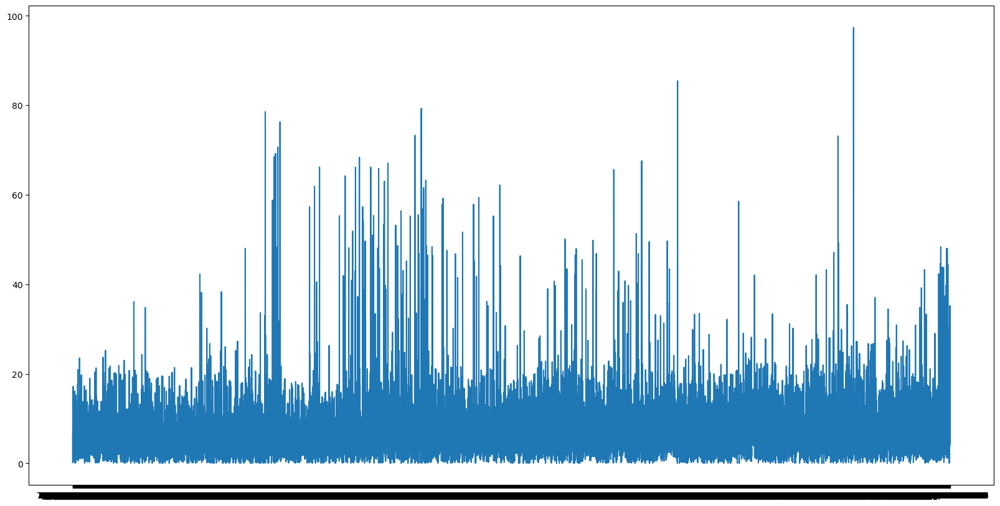

In [16]:
df_station = df[df['Station Name'] == "PALO ALTO CA / HAMILTON #1"]
# plot timeseries
plt.figure(figsize=(20, 10))
plt.plot(df_station['End Date'], df_station['Energy (kWh)'])
plt.show()

In [10]:
df_station.columns

Index(['Station Name', 'MAC Address', 'Org Name', 'Start Date',
       'Start Time Zone', 'End Date', 'End Time Zone',
       'Transaction Date (Pacific Time)', 'Total Duration (hh:mm:ss)',
       'Charging Time (hh:mm:ss)', 'Energy (kWh)', 'GHG Savings (kg)',
       'Gasoline Savings (gallons)', 'Port Type', 'Port Number', 'Plug Type',
       'EVSE ID', 'Address 1', 'City', 'State/Province', 'Postal Code',
       'Country', 'Latitude', 'Longitude', 'Currency', 'Fee', 'Ended By',
       'Plug In Event Id', 'Driver Postal Code', 'User ID', 'County',
       'System S/N', 'Model Number'],
      dtype='object')

In [22]:
df_station.iloc[0]

Station Name                       PALO ALTO CA / HAMILTON #1
MAC Address                               000D:6F00:015A:9D76
Org Name                                    City of Palo Alto
Start Date                                2011-07-29 20:17:00
Start Time Zone                                           PDT
End Date                                      7/29/2011 23:20
End Time Zone                                             PDT
Transaction Date (Pacific Time)               7/29/2011 23:20
Total Duration (hh:mm:ss)                             3:03:32
Charging Time (hh:mm:ss)                              1:54:03
Energy (kWh)                                         6.249457
GHG Savings (kg)                                        2.625
Gasoline Savings (gallons)                              0.784
Port Type                                             Level 2
Port Number                                                 2
Plug Type                                               J1772
EVSE ID 

In [19]:
# 

array(['City of Palo Alto', 'City of Palo Alto '], dtype=object)